## Air ECG 模型训练

# step1 数据加载

In [4]:
import scipy
import math
import random
import argparse
from time import time
import sys
from pathlib import Path
from typing import Iterable, Optional
import numpy as np
import torch
import torch.multiprocessing
torch.multiprocessing.set_sharing_strategy('file_system')
import torch.nn as nn
from torch.utils.tensorboard import SummaryWriter
import misc
from misc import NativeScalerWithGradNormCount as NativeScaler
import pickle
import neurokit2 as nk
import matplotlib
import os
import torch
import torch.nn.functional as F
import scipy.io as sio
from torch.nn.utils.parametrizations import weight_norm
from torch.utils.data import TensorDataset, DataLoader
from einops import rearrange, repeat
from einops.layers.torch import Rearrange
import time
import torch.optim as optim
from sklearn.preprocessing import StandardScaler
from RCGshift import findShift, find_best_shift

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
data = scipy.io.loadmat(r"D:\Code\Python\ECG\transfer_3376759_files_d8379d48\theTrainingData\20250515mat\cailike_1.mat")

In [27]:
data

{'__header__': b'MATLAB 5.0 MAT-file Platform: nt, Created on: Tue Apr 22 15:22:51 2025',
 '__version__': '1.0',
 '__globals__': [],
 'data': array([[array([[ 506.85971975,  505.63260913,  544.45385933, ...,  623.60217446,
                  639.87195492,  698.15248251],
                [ 355.54468632,  356.01302981,  380.86742163, ...,  385.35597036,
                  398.85789156,  461.91111207],
                [ 115.05335569,  124.43870306,   91.43531322, ...,  136.48784137,
                  140.38145542,   63.89856339],
                ...,
                [-137.67421246, -154.21509743, -168.17927361, ..., -179.19421196,
                 -169.53110695, -146.83127403],
                [-189.3633604 , -190.80400467, -197.71575928, ..., -212.35466003,
                 -217.26965904, -191.65992737],
                [-224.13730621, -214.56241608, -225.30198097, ..., -191.42389297,
                 -212.48817444, -248.6884594 ]])                                 ,
         array([[-117.7

In [28]:
print(data["data"][0][0].shape)
print(data["data"][0][1].shape)
print(data["data"][0][2].shape)
rcg_signal = data["data"][0][0]
ecg_signal = data["data"][0][1]
position = data["data"][0][2]

(11000, 50)
(1, 11000)
(50, 3)


In [4]:
print(ecg_signal)

[[151.46116736 153.43613397 151.50865792 ... 127.74698718 129.91865743
  129.86083883]]


In [6]:
scaler = StandardScaler()
theRcgData = scaler.fit_transform(rcg_signal)
print(theRcgData.shape)

(36000, 50)


In [7]:
scaler = StandardScaler()
theEcgData = scaler.fit_transform(ecg_signal.transpose()).transpose()
print(theEcgData.shape)

(1, 36000)


In [8]:

print(theEcgData)

[[1.5212599  1.64163514 1.52415447 ... 0.0758682  0.20823264 0.20470857]]


In [9]:

def min_max_normalization(data):
    min_val = np.min(data, axis=(0, 1), keepdims=True)
    max_val = np.max(data, axis=(0, 1), keepdims=True)
    normalized_data = (data - min_val) / (max_val - min_val)
    return normalized_data


def sliding_window_sampling(time_series, sample_size, step):
    num_samples = (time_series.shape[1] - sample_size) // step + 1
    samples = [time_series[:, i * step : i * step + sample_size] for i in range(num_samples)]
    return np.array(samples)

#print(rcg_signal.shape, ecg_signal.shape, position.shape)
rcg_data = min_max_normalization(rcg_signal)
RCG_segmented = sliding_window_sampling(np.transpose(rcg_data), 640, 30)
rcg_data.shape, RCG_segmented.shape
#RCG_segmented = np.expand_dims(RCG_segmented, axis=2)  # 增加一个维度

((36000, 50), (1179, 50, 640))

In [10]:
theEcgData = theEcgData.squeeze()
ecg_clean = nk.ecg_clean(theEcgData, sampling_rate=200)
ecg_clean.shape

(36000,)

In [11]:
position

array([[ 4.,  2.,  8.],
       [ 3.,  5., 13.],
       [ 5.,  3., 13.],
       [ 3.,  4., 13.],
       [ 7.,  3., 10.],
       [ 3.,  6.,  6.],
       [ 5.,  4., 13.],
       [ 3.,  6.,  7.],
       [ 3.,  3., 13.],
       [ 7.,  1., 13.],
       [ 4.,  5.,  8.],
       [ 4.,  7.,  8.],
       [ 3.,  5., 11.],
       [ 5.,  5.,  4.],
       [ 8.,  4., 10.],
       [ 4.,  3.,  7.],
       [ 5.,  4.,  8.],
       [ 5.,  4.,  7.],
       [ 7.,  3., 14.],
       [ 1.,  5.,  9.],
       [ 5.,  6.,  5.],
       [ 3.,  4., 15.],
       [ 3.,  6.,  6.],
       [ 5.,  5., 12.],
       [ 5.,  6., 10.],
       [ 4.,  6.,  9.],
       [ 3.,  7.,  7.],
       [ 5.,  2.,  8.],
       [ 4.,  5., 16.],
       [ 0.,  3., 11.],
       [ 6.,  5.,  9.],
       [ 4.,  4.,  9.],
       [ 6.,  5.,  7.],
       [ 8.,  2.,  9.],
       [ 4.,  4.,  9.],
       [ 5.,  5., 14.],
       [ 7.,  3.,  9.],
       [ 4.,  4., 14.],
       [ 4.,  1.,  9.],
       [ 6.,  3.,  4.],
       [ 5.,  2.,  9.],
       [ 4.,  5.

In [12]:


# 体素网格的维度
voxel_grid_dimensions = (9, 9, 17)

# 体素范围
voxel_range = {
    "x": (-0.4, 0.4),
    "y": (0.35, 0.6),
    "z": (-0.4, 0.4),
}

# 体素步长计算
voxel_step = {
    "x": (voxel_range["x"][1] - voxel_range["x"][0]) / (voxel_grid_dimensions[0] - 1),
    "y": (voxel_range["y"][1] - voxel_range["y"][0]) / (voxel_grid_dimensions[1] - 1),
    "z": (voxel_range["z"][1] - voxel_range["z"][0]) / (voxel_grid_dimensions[2] - 1),
}

# 示例的索引数组
index_array = position
# 计算真实空间坐标
voxel_positions_real = np.zeros_like(index_array)

voxel_positions_real[:, 0] = voxel_range["x"][0] + index_array[:, 0] * voxel_step["x"]
voxel_positions_real[:, 1] = voxel_range["y"][0] + index_array[:, 1] * voxel_step["y"]
voxel_positions_real[:, 2] = voxel_range["z"][0] + index_array[:, 2] * voxel_step["z"]

print(voxel_positions_real)


[[ 0.       0.4125   0.     ]
 [-0.1      0.50625  0.25   ]
 [ 0.1      0.44375  0.25   ]
 [-0.1      0.475    0.25   ]
 [ 0.3      0.44375  0.1    ]
 [-0.1      0.5375  -0.1    ]
 [ 0.1      0.475    0.25   ]
 [-0.1      0.5375  -0.05   ]
 [-0.1      0.44375  0.25   ]
 [ 0.3      0.38125  0.25   ]
 [ 0.       0.50625  0.     ]
 [ 0.       0.56875  0.     ]
 [-0.1      0.50625  0.15   ]
 [ 0.1      0.50625 -0.2    ]
 [ 0.4      0.475    0.1    ]
 [ 0.       0.44375 -0.05   ]
 [ 0.1      0.475    0.     ]
 [ 0.1      0.475   -0.05   ]
 [ 0.3      0.44375  0.3    ]
 [-0.3      0.50625  0.05   ]
 [ 0.1      0.5375  -0.15   ]
 [-0.1      0.475    0.35   ]
 [-0.1      0.5375  -0.1    ]
 [ 0.1      0.50625  0.2    ]
 [ 0.1      0.5375   0.1    ]
 [ 0.       0.5375   0.05   ]
 [-0.1      0.56875 -0.05   ]
 [ 0.1      0.4125   0.     ]
 [ 0.       0.50625  0.4    ]
 [-0.4      0.44375  0.15   ]
 [ 0.2      0.50625  0.05   ]
 [ 0.       0.475    0.05   ]
 [ 0.2      0.50625 -0.05   ]
 [ 0.4    

将ECG.csv替换mat中ecg

In [13]:
import os
import scipy.io
import pandas as pd

def load_mat_data(mat_file_path):
    """加载 .mat 文件"""
    mat_data = scipy.io.loadmat(mat_file_path)
    return mat_data

def save_mat_data(mat_data, mat_file_path):
    """保存修改后的 .mat 文件"""
    scipy.io.savemat(mat_file_path, mat_data)

def process_files(csv_dir, mat_dir):
    """处理文件，替换 mat 中的 ecg 数据"""
    
    # 遍历所有日期文件夹
    for folder in os.listdir(csv_dir):
        csv_folder = os.path.join(csv_dir, folder)
        mat_folder = os.path.join(mat_dir, folder)

        if os.path.isdir(csv_folder) and os.path.isdir(mat_folder):
            csv_files = sorted(os.listdir(csv_folder), key=lambda x: int(x.split('.')[0]))  # 获取 CSV 文件列表，并按顺序排序
            mat_files = sorted(os.listdir(mat_folder), key=lambda x: int(x.split('.')[0]))  # 获取 MAT 文件列表，并按顺序排序

            # 确保 CSV 文件和 MAT 文件一一对应
            if len(csv_files) != len(mat_files):
                print(len(csv_files), len(mat_files))
                print(f"Error: Mismatch in the number of CSV files and MAT files in folder {folder}")
                continue

            for i in range(len(csv_files)):
                # 获取 CSV 文件和 MAT 文件
                csv_file_path = os.path.join(csv_folder, csv_files[i])
                mat_file_path = os.path.join(mat_folder, mat_files[i])

                if csv_file_path.endswith(".csv") and mat_file_path.endswith(".mat"):
                    # 读取 CSV 文件中的 ECG 数据
                    df = pd.read_csv(csv_file_path)
                    ecg_data = df['ECG'].values  
                    

                    # 加载 MAT 文件
                    mat_data = load_mat_data(mat_file_path)

                    # 替换 MAT 中的 ECG 数据
                    if 'data' in mat_data:
                        mat_data['data'][0][1] = ecg_data  # 替换 ECG 数据
    

                        # 保存修改后的 MAT 文件
                        save_mat_data(mat_data, mat_file_path)
                        print(f"Replaced ECG data in {mat_files[i]} and saved.")
                    else:
                        print(f"No 'data' key in {mat_file_path}, skipping.")
                else:
                    print(f"Skipping file: {csv_file_path} or {mat_file_path}")

# 使用示例
csv_dir = r"D:\Code\Python\ECG\labotroData\Clip"
mat_dir = r"D:\Code\Python\ECG\labotroData\Data"
process_files(csv_dir, mat_dir)


Replaced ECG data in 1.mat and saved.
Replaced ECG data in 2.mat and saved.
Replaced ECG data in 3.mat and saved.
Replaced ECG data in 4.mat and saved.
Replaced ECG data in 5.mat and saved.
Replaced ECG data in 6.mat and saved.
Replaced ECG data in 7.mat and saved.
Replaced ECG data in 8.mat and saved.
Replaced ECG data in 9.mat and saved.
Replaced ECG data in 10.mat and saved.
Replaced ECG data in 11.mat and saved.
Replaced ECG data in 12.mat and saved.
Replaced ECG data in 13.mat and saved.
Replaced ECG data in 14.mat and saved.
Replaced ECG data in 15.mat and saved.
Replaced ECG data in 16.mat and saved.
Replaced ECG data in 17.mat and saved.
Replaced ECG data in 18.mat and saved.
Replaced ECG data in 19.mat and saved.
Replaced ECG data in 21.mat and saved.
Replaced ECG data in 22.mat and saved.
Replaced ECG data in 1.mat and saved.
Replaced ECG data in 2.mat and saved.
Replaced ECG data in 3.mat and saved.
Replaced ECG data in 4.mat and saved.
Replaced ECG data in 5.mat and saved.


# Step2 数据预处理

In [5]:

scaler = StandardScaler()
# 体素网格的维度和范围
voxel_grid_dimensions = (9, 9, 17)
voxel_range = {
    "x": (-0.4, 0.4),
    "y": (0.35, 0.6),
    "z": (-0.4, 0.4),
}
# 体素步长计算
voxel_step = {
    "x": (voxel_range["x"][1] - voxel_range["x"][0]) / (voxel_grid_dimensions[0] - 1),
    "y": (voxel_range["y"][1] - voxel_range["y"][0]) / (voxel_grid_dimensions[1] - 1),
    "z": (voxel_range["z"][1] - voxel_range["z"][0]) / (voxel_grid_dimensions[2] - 1),
}

def cos_loss(pred, target):#余弦相似度损失（只关注波形不关注幅度）
    """
    pred:  (batch_size, seq_length)
    target:(batch_size, seq_length)
    """
    # shape=(batch_size,)
    cos_sim = F.cosine_similarity(pred, target, dim=1)
    
    loss = 1 - cos_sim.mean()
    return loss

# 定义数据加载和预处理函数
def load_files(directory):
    """
    从指定的文件夹中加载所有的 .pkl 文件。
    返回加载后的数据字典列表。
    """
    data_list = []
    
    # 遍历文件夹中的所有文件
    for file_name in os.listdir(directory):
        if file_name.endswith(('_1.mat', '_2.mat', '_3.mat')):
            file_path = os.path.join(directory, file_name)
            # 使用 pickle 加载 .pkl 文件
            with open(file_path, 'rb') as f:
                data = sio.loadmat(f)
                data = data['data']
                data_list.append(data)
    
    return data_list

def load_files_from_subfolders(base_directory):
    """
    从指定的根文件夹（base_directory）及其所有子文件夹中加载所有的 .mat 文件。
    返回加载后的数据字典列表。
    """
    data_list = []
    
    # 遍历根目录下的所有子文件夹（如0326, 0331等）
    for folder_name in os.listdir(base_directory):
        folder_path = os.path.join(base_directory, folder_name)
        
        # 确保是文件夹
        if os.path.isdir(folder_path):
            # 使用 os.walk 遍历每个子文件夹及其中的文件
            for root, dirs, files in os.walk(folder_path):
                for file_name in files:
                    if file_name.endswith(('_1.mat', '_2.mat', '_3.mat')):
                        file_path = os.path.join(root, file_name)
                        # 加载 .mat 文件
                        data = sio.loadmat(file_path)
                        data = data['data']  # 假设mat文件中的数据存储在 'data' 键下
                        data_list.append(data)
    
    return data_list

    

# def quantization(data, num_levels=256):
#     norm = (data - np.min(data)) / (np.max(data) - np.min(data))
#     quantized_data = np.round(norm * (num_levels - 1))
#     return quantized_data

def min_max_normalization(data):
    min_val = np.min(data, axis=(0, 1), keepdims=True)
    max_val = np.max(data, axis=(0, 1), keepdims=True)
    normalized_data = (data - min_val) / (max_val - min_val)
    #normalized_data = normalized_data * 2 - 1
    return normalized_data

def min_max_normalization_ecg(data):
    min_val = np.min(data)
    max_val = np.max(data)
    normalized_data = (data - min_val) / (max_val - min_val)
    #normalized_data = normalized_data * 2 - 1
    return normalized_data


def sliding_window_sampling(time_series, sample_size, step):
    num_samples = (time_series.shape[1] - sample_size) // step + 1
    samples = [time_series[:, i * step : i * step + sample_size] for i in range(num_samples)]
    return np.array(samples)

def sliding_window_sampling1d(time_series, sample_size, step):
    num_samples = (len(time_series) - sample_size) // step + 1
    samples = [time_series[i * step : i * step + sample_size] for i in range(num_samples)]
    return np.array(samples)

def restore_real_coordinates(index_array):
    """
    将 pozXYZ 的体素网格索引转换为真实的物理坐标。
    """
    voxel_positions_real = np.zeros_like(index_array)

    voxel_positions_real[:, 0] = voxel_range["x"][0] + index_array[:, 0] * voxel_step["x"]
    voxel_positions_real[:, 1] = voxel_range["y"][0] + index_array[:, 1] * voxel_step["y"]
    voxel_positions_real[:, 2] = voxel_range["z"][0] + index_array[:, 2] * voxel_step["z"]
    
    return voxel_positions_real

def preprocess_data(data_dict, rcg_sample_size=640, ecg_sample_size=640, step=30, sampling_rate=200):
    """
    对单个数据字典进行预处理。
    """
    # 处理 RCG 数据
    #rcg_data = data_dict[0][0][0].astype(np.float32)
    rcg_data = data_dict[0][0].astype(np.float32)
    #rcg_data = min_max_normalization(rcg_data)
    rcg_data = scaler.fit_transform(rcg_data)
    rcgCopy = rcg_data.copy().mean(axis=1)

    # 处理 ECG 数据
    #ecg_data = data_dict[0][0][1].astype(np.float32)
    ecg_data = data_dict[0][1].astype(np.float32)
    ecg_data = scaler.fit_transform(ecg_data.transpose()).transpose().squeeze()

    # 量化清理后的 ECG 数据
    #ECG_quantized = quantization(ecg_clean)
    #ecg_norm = scaler.fit_transform(ecg_data).transpose().squeeze()
    # 使用 neurokit2 进行 ECG 信号清理
    ecg_clean = nk.ecg_clean(ecg_data, sampling_rate=sampling_rate)
    #ecg_clean = min_max_normalization_ecg(ecg_clean)
    ecgCopy = ecg_clean.copy()

    
    shiftIndex = find_best_shift(ecgCopy, rcgCopy) # the diff = ecg_first_peak - rcg_first_peak

    if shiftIndex > 0:
        ecg_clean = ecg_clean[shiftIndex:]
        rcg_data = rcg_data[:-shiftIndex, :]
    elif shiftIndex < 0:
        ecg_clean = ecg_clean[:shiftIndex]
        rcg_data = rcg_data[-shiftIndex:, :]
    else:
        pass
    

    ECG_segmented = sliding_window_sampling1d(ecg_clean, ecg_sample_size, step)
    RCG_segmented = sliding_window_sampling(np.transpose(rcg_data), rcg_sample_size, step)
    RCG_segmented = np.expand_dims(RCG_segmented, axis=-2)  # 增加一个维度

      # 还原 pozXYZ 的真实坐标
    #pozXYZ_data = data_dict[0][0][2].astype(np.float32)
    pozXYZ_data = data_dict[0][2].astype(np.float32)
    pozXYZ_real = restore_real_coordinates(pozXYZ_data)  

    # 确保 pozXYZ 的重复次数与 ECG_segmented 的第一维度匹配
    num_segments = ECG_segmented.shape[0]
    pozXYZ_repeated = np.tile(pozXYZ_real, (num_segments, 1, 1))

    return RCG_segmented, ECG_segmented, pozXYZ_repeated







# 主函数：加载所有文件并预处理
def Preprocessing(directory, sampling_rate=200):
    """
    加载目录下的所有 .pkl 文件，并对其进行预处理。
    返回预处理后的 RCG、ECG 和 pozXYZ 数据列表。
    """
    # 加载所有 .pkl 文件
    #all_data = load_files(directory)
    all_data = load_files_from_subfolders(directory)
    # 初始化空列表，用于存储处理后的数据
    all_RCG = []
    all_ECG = []
    all_pozXYZ = []

    # 对每个数据字典进行预处理
    for data_dict in all_data:
        RCG_segmented, ECG_segmented, pozXYZ_segmented = preprocess_data(data_dict, sampling_rate=sampling_rate)
        
        # 展开并拼接结果
        #print(RCG_segmented.shape, ECG_segmented.shape, pozXYZ_segmented.shape)
        all_RCG.append(RCG_segmented)
        all_ECG.append(ECG_segmented)
        all_pozXYZ.append(pozXYZ_segmented)
    

    # 将所有文件处理后的结果拼接成统一的数组

    all_RCG = np.concatenate(all_RCG, axis=0)
    all_ECG = np.concatenate(all_ECG, axis=0)
    all_pozXYZ = np.concatenate(all_pozXYZ, axis=0)

    return all_RCG, all_ECG, torch.tensor(all_pozXYZ, dtype=torch.float32)




# Step3 创建数据集

In [6]:
def build_dataset(is_train, args):
    #path = os.path.join(args.root_path, 'Dataset_Aligned_BadFileDeleted' if is_train else 'Dataset_Aligned_BadFileDeleted_test')
    path = os.path.join(args.root_path, r'transfer_3376759_files_d8379d48\theTrainingData' if is_train else r'transfer_3376759_files_d8379d48\theTestingData')
    RCG, ECG, pozXYZ = Preprocessing(path)
    # 打印处理后的形状
    if is_train:
        print("Training RCG shape:", RCG.shape) 
        print("Training ECG shape:", ECG.shape)  
        print("Training pozXYZ shape:", pozXYZ.shape)
    else:
        print("Testing RCG shape:", RCG.shape) 
        print("Testing ECG shape:", ECG.shape)  
        print("Testing pozXYZ shape:", pozXYZ.shape)
    dataset = TensorDataset(torch.tensor(RCG, dtype=torch.float32), torch.tensor(ECG, dtype=torch.float32), pozXYZ)

    return dataset


# Step4 构建Parser


In [7]:
def get_args_parser():
    parser = argparse.ArgumentParser('AirECG Training', add_help=False)
    
    # Training parameters
    parser.add_argument('--batch_size', default=64, type=int, 
                        help='Batch size per GPU (effective batch size is batch_size * accum_iter * # gpus)')
    parser.add_argument('--epochs', default=301, type=int)
    parser.add_argument('--accum_iter', default=1, type=int, 
                        help='Accumulate gradient iterations (for increasing the effective batch size under memory constraints)')

    # Optimizer parameters
    parser.add_argument('--weight_decay', type=float, default=0.0001, #origin 0.0001
                        help='weight decay (default: 0.0001)')
    parser.add_argument('--lr', type=float, default=0.0001, #0.001
                        metavar='LR', 
                        help='learning rate (absolute lr)')
    parser.add_argument('--lr_scheduler', type=str, default='cosine', help='lr scheduler (default: cosine)')
    
    # Path parameters
    parser.add_argument('--root_path', default='D:\Code\Python\ECG', 
                        help='path where to save, empty for no saving')
    parser.add_argument('--output_dir', default='./output_dir_pretrained', 
                        help='path where to save, empty for no saving')
    parser.add_argument('--log_dir', default='./output_dir_pretrained', 
                        help='path where to tensorboard log')

    # Resume training
    parser.add_argument('--resume', default='', 
                        help='resume from checkpoint')

    # Miscellaneous
    parser.add_argument('--start_epoch', default=1, type=int, metavar='N', 
                        help='start epoch')
    parser.add_argument('--num_workers', default=16, type=int)
    parser.add_argument('--pin_mem', action='store_true', 
                        help='Pin CPU memory in DataLoader for more efficient (sometimes) transfer to GPU.')
    parser.add_argument('--no_pin_mem', action='store_false', dest="pin_mem")
    
    parser.set_defaults(pin_mem=True)
    
    return parser
a = nn.Parameter(torch.tensor(0.5))


# Step 5 训练函数

In [5]:
# #速度慢
# def train_one_epoch(model: torch.nn.Module, criterion: torch.nn.Module,
#                     data_loader: Iterable, optimizer: torch.optim.Optimizer,
#                     device: torch.device, epoch: int, loss_scaler, max_norm: float = 0,
#                     log_writer=None, args=None):
    
#     model.train(True)
#     print_freq = 2
#     accum_iter = args.accum_iter

#     if log_writer is not None:
#         print('log_dir: {}'.format(log_writer.log_dir))



#     for data_iter_step, [inputs, posXYZ_tensor, labels] in enumerate(data_loader, 0):

#         start_time = time.perf_counter()
#         inputs = inputs.to(device, non_blocking=True)
#         posXYZ_tensor = posXYZ_tensor.to(device, non_blocking=True)
#         labels = labels.to(device, non_blocking=True)
#         load_data_time = time.perf_counter() - start_time

#         start_time = time.perf_counter()
#         outputs = model(inputs, posXYZ_tensor)
#         model_process_time = time.perf_counter() - start_time

#         # Warmup learning rate
#         warmup_lr = args.lr
#         optimizer.param_groups[0]["lr"] = warmup_lr
#         start_time = time.perf_counter()
#         loss = criterion(outputs, labels.long())
#         loss /= accum_iter

#         loss_scaler(loss, optimizer, clip_grad=max_norm,
#                     parameters=model.parameters(), create_graph=False,
#                     update_grad=(data_iter_step + 1) % accum_iter == 0)

#         loss_value = loss.item()

#         if (data_iter_step + 1) % accum_iter == 0:
#             optimizer.zero_grad()
#         backward_time = time.perf_counter() - start_time

#         if not math.isfinite(loss_value):
#             print("Loss is {}, stopping training".format(loss_value))
#             sys.exit(1)
        
#         print(f"Load data time: {load_data_time:.4f}, Model process time: {model_process_time:.4f}, "
#               f"Backward time: {backward_time:.4f}")

    

#         if log_writer is not None and (data_iter_step + 1) % accum_iter == 0:
#             epoch_1000x = int((data_iter_step / len(data_loader) + epoch) * 1000)
#             log_writer.add_scalar('loss', loss_value, epoch_1000x)
#             log_writer.add_scalar('lr', warmup_lr, epoch_1000x)
#             print(f"Epoch: {epoch}, Step: {data_iter_step}, Loss: {loss_value}, LR: {warmup_lr}")

In [8]:

from torch.amp import autocast, GradScaler

def train_one_epoch(model: torch.nn.Module, criterion: torch.nn.Module,
                    data_loader: Iterable, optimizer: torch.optim.Optimizer,
                    device: torch.device, epoch: int, loss_scaler, max_norm: float,
                    log_writer=None, args=None):

    model.train(True)
    print_freq = 2
    scaler = GradScaler()  # 使用 GradScaler 进行混合精度训练


    if log_writer is not None:
        print('log_dir: {}'.format(log_writer.log_dir))
    
    history_ecg = None

    for data_iter_step, [inputs, labels, posXYZ_tensor] in enumerate(data_loader, 0):
        if history_ecg is None:
            batch_size = inputs.size(0)
            history_ecg = torch.zeros((batch_size, 640), device=device)
        # 数据加载
        start_time = time.perf_counter()
        inputs = inputs.to(device, non_blocking=True)
        posXYZ_tensor = posXYZ_tensor.to(device, non_blocking=True)
        labels = labels.to(device, non_blocking=True)
        load_data_time = time.perf_counter() - start_time

        # 前向传播和损失计算
        start_time = time.perf_counter()
        with autocast(device_type='cuda', dtype=torch.float16):  # 使用混合精度
            #outputs = model(inputs, posXYZ_tensor, history_ecg).flatten(1)
            outputs = model(inputs, posXYZ_tensor).flatten(1)
            # 对齐预测信号
            #aligned_outputs = align_signal(outputs.float(), labels.float())
            #outputs = model(inputs)
            #loss = criterion(aligned_outputs.float(), labels.float())
            loss = criterion(outputs.float(), labels.float())
        model_process_time = time.perf_counter() - start_time

        # 反向传播和参数更新
        start_time = time.perf_counter()
        scaler.scale(loss).backward()  # 缩放损失并进行反向传播

        # 梯度裁剪（如果需要）
        if max_norm > 0:
            scaler.unscale_(optimizer)
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm)

        scaler.step(optimizer)  # 更新模型参数
        scaler.update()  # 更新缩放因子
        optimizer.zero_grad()  # 清除梯度缓存
        backward_time = time.perf_counter() - start_time

        history_ecg = outputs.detach()

        # 输出时间信息
        print(f"Load data time: {load_data_time:.4f}, Model process time: {model_process_time:.4f}, "
              f"Backward time: {backward_time:.4f}")

        # 记录日志
        if log_writer is not None:
            epoch_1000x = int((data_iter_step / len(data_loader) + epoch) * 1000)
            log_writer.add_scalar('loss', loss.item(), epoch_1000x)
            log_writer.add_scalar('lr', optimizer.param_groups[0]["lr"], epoch_1000x)
            print(f"Epoch: {epoch}, Step: {data_iter_step}, Loss: {loss.item()}, LR: {optimizer.param_groups[0]['lr']}")


# Step6 评估函数

In [10]:


@torch.no_grad()
def evaluate(data_loader, model, device):
    #criterion = CrossCorrelationAlignmentLoss(alpha=0.5, beta=0.5)
    criterion = nn.MSELoss()
    #mse_loss_fn = torch.nn.MSELoss()
    #criterion = lambda pred, target: a * mse_loss_fn(pred, target) + (1 - a) * cos_loss(pred, target)

    metric_logger = misc.MetricLogger(delimiter=" ")
    header = 'Test:'

    # 切换到评估模式
    model = model.to(device)
    model.eval()

    # 累积损失
    accumulate_loss = 0

    history_ecg = None

    for i, batch in enumerate(metric_logger.log_every(data_loader, 10, header)):

        # 假设 batch 包含 inputs、posXYZ_tensor、labels
        inputs = batch[0].to(device, non_blocking=True)
        labels = batch[1].to(device, non_blocking=True)
        posXYZ_tensor = batch[2].to(device, non_blocking=True)
        
        
        if history_ecg is None:
            batch_size = inputs.size(0)
            history_ecg = torch.zeros((batch_size, 640), device=device)

        # 计算输出
        #outputs = model(inputs, posXYZ_tensor, history_ecg).flatten(1)
        outputs = model(inputs, posXYZ_tensor).flatten(1)
        #aligned_outputs = align_signal(outputs.float(), labels.float())
        #outputs = model(inputs)
        #loss = criterion(aligned_outputs, labels.float())
        loss = criterion(outputs.float(), labels.float())

        # 累积损失
        accumulate_loss += loss.item()

        # 更新损失记录
        metric_logger.update(loss=loss.item())

        history_ecg = outputs.detach()

    # 在所有进程之间同步统计信息（如果使用分布式训练）
    metric_logger.synchronize_between_processes()

    # 输出最终的平均损失
    print(f'* Loss {metric_logger.loss.global_avg:.3f}')

    return {k: meter.global_avg for k, meter in metric_logger.meters.items()}


# Step6 构建模型

In [8]:
from model import ECGFormer
encoder_parameter = 3, 32, [1,32], [4,640], 80, 1, 50, 1
num_inputs = 4
num_channels = [4]*12 # origin [4]*9

In [11]:
from models.airECG_catFusion_newTCN import airECG_catFusion_newTCN
net = airECG_catFusion_newTCN(hidden_size=60,output_size=640)

d:\anaconda3\envs\ECG\lib\site-packages\torch\nn\utils\weight_norm.py:143: FutureWarning: `torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.
  WeightNorm.apply(module, name, dim)


In [12]:
# def a cod loss
def cos_loss(pred, label):
    """
    pred:  (batch_size, seq_length)
    label:(batch_size, seq_length)
    """
    # shape=(batch_size,)
    cos_sim = F.cosine_similarity(pred, label, dim=1)
    
    loss = 1 - cos_sim.mean()
    return loss

# step7 主函数

In [13]:

def main(args, mode='train'):
    print(f"{mode} mode...")

    if mode == 'train':
        # 构建训练和验证数据集
        dataset_train = build_dataset(is_train=True, args=args)
        dataset_val = build_dataset(is_train=False, args=args)

        # 构建采样器和数据加载器
        sampler_train = torch.utils.data.RandomSampler(dataset_train)
        sampler_val = torch.utils.data.SequentialSampler(dataset_val)

        data_loader_train = torch.utils.data.DataLoader(
            dataset_train, sampler=sampler_train,
            batch_size=args.batch_size,
            num_workers=args.num_workers,
            pin_memory=args.pin_mem,
            drop_last=False,
        )

        data_loader_val = torch.utils.data.DataLoader(
            dataset_val, sampler=sampler_val,
            batch_size=args.batch_size,
            num_workers=args.num_workers,
            pin_memory=args.pin_mem,
            drop_last=False,
        )

        #构建模型
        #model = ECGFormer(encoder_parameter, num_inputs, num_channels).to(device)
        model = net.to(device)
        

        # 损失函数和优化器
        mse_loss_fn = torch.nn.MSELoss()
        #criterion = lambda pred, target: torch.sigmoid(a) * mse_loss_fn(pred, target) + (1 - torch.sigmoid(a)) * cos_loss(pred, target)
        #criterion = CrossCorrelationAlignmentLoss(alpha=0.5, beta=0.5)
        criterion = torch.nn.MSELoss()  
        optimizer = torch.optim.AdamW(list(model.parameters()) + [a], lr=args.lr, weight_decay=args.weight_decay)

        # scheduler
        if args.lr_scheduler == "cosine":
            scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer=optimizer, eta_min=args.lr * 0.01, T_max=args.epochs/10)
        elif args.lr_scheduler == "step":
            scheduler = optim.lr_scheduler.StepLR(optimizer=optimizer, gamma=0.9, step_size=1)

        # 日志记录器和梯度缩放器
        os.makedirs(args.log_dir, exist_ok=True)
        log_writer = SummaryWriter(log_dir=args.log_dir)
        loss_scaler = NativeScaler()

        # 加载模型
        misc.load_model(args=args, model_without_ddp=model, optimizer=optimizer, loss_scaler=loss_scaler)

        # # 早停
        # best_loss = float('inf')
        # early_stop_counter = 0
        # patience = 5
        # delta = 0.001
        # val_loss = float('inf')

        # 初始化记录最优验证损失的变量
        best_val_loss = float('inf')
        best_epoch = -1


        # 开始训练和评估
        for epoch in range(args.start_epoch, args.epochs):
            print(f"Epoch {epoch}")
            print(f"Length of data_loader_train is {len(data_loader_train)}")

            model.train()
            # 训练一个 epoch
            print("Training...")
            train_stats = train_one_epoch(
                model, criterion, data_loader_train,
                optimizer, device, epoch,
                loss_scaler, max_norm=5.0,
                log_writer=log_writer,
                args=args
            )
            scheduler.step()
            log_writer.add_scalar('lr', scheduler.get_last_lr()[0], epoch)

            #保存模型检查点
            if args.output_dir:
                print("Saving checkpoints...")
                misc.save_model(
                    args=args, model=model, model_without_ddp=model, optimizer=optimizer,
                    loss_scaler=loss_scaler, epoch=epoch
                )

             # 每个 epoch 结束时进行验证
            if epoch > 0:
                print("Evaluating...")
                model.eval()
                val_stats = evaluate(data_loader_val, model, device)  
                val_loss = val_stats['loss']

                if log_writer is not None:
                    log_writer.add_scalar('loss/validation_loss', val_loss, epoch)
                
                #     # Early stopping 
                # if val_loss < best_loss - delta:
                #     best_loss = val_loss
                #     early_stop_counter = 0
                #     #保存最好的模型
                #     misc.save_model(
                #         args=args, model=model, model_without_ddp=model, optimizer=optimizer,
                #         loss_scaler=loss_scaler, epoch=epoch
                #     )
                # else:
                #     early_stop_counter += 1
                #     if early_stop_counter >= patience:
                #         print("Early stopping triggered.")
                #         break
            # 检查是否是最优验证损失
            if val_loss < best_val_loss:
                best_val_loss = val_loss
                best_epoch = epoch
                print(f"New best model found at epoch {epoch}, validation loss: {val_loss:.4f}")
        # 打印验证损失最小的结果
        print(f"Best validation loss: {best_val_loss:.4f} at epoch {best_epoch}")
                

    else:
        print(f"No training mode specified. Current mode is {mode}.")
        # eval 已经放在了每个epoch结束后执行，如果要单独执行，可以在这里调用 evaluate 函数


# Step8 执行

In [22]:

parser = get_args_parser()
args, unkowns = parser.parse_known_args()

dataset_train = build_dataset(is_train=True, args=args)
dataset_val = build_dataset(is_train=False, args=args)

data_loader_train = torch.utils.data.DataLoader(
            dataset_train, shuffle=True,
            batch_size=args.batch_size,
            num_workers=args.num_workers,
            pin_memory=args.pin_mem,
            drop_last=True,
        )

data_loader_val = torch.utils.data.DataLoader(
            dataset_val, shuffle=True,
            batch_size=args.batch_size,
            num_workers=args.num_workers,
            pin_memory=args.pin_mem,
            drop_last=True,
        )
for i, [input, labels, pos] in enumerate(data_loader_val):
    print(f"Batch {i}:input shape: {input.shape}, label shape: {labels.shape}, pos shape: {pos.shape}")



Training RCG shape: (25900, 50, 1, 640)
Training ECG shape: (25900, 640)
Training pozXYZ shape: torch.Size([25900, 50, 3])
Testing RCG shape: (3114, 50, 1, 640)
Testing ECG shape: (3114, 640)
Testing pozXYZ shape: torch.Size([3114, 50, 3])
Batch 0:input shape: torch.Size([64, 50, 1, 640]), label shape: torch.Size([64, 640]), pos shape: torch.Size([64, 50, 3])
Batch 1:input shape: torch.Size([64, 50, 1, 640]), label shape: torch.Size([64, 640]), pos shape: torch.Size([64, 50, 3])
Batch 2:input shape: torch.Size([64, 50, 1, 640]), label shape: torch.Size([64, 640]), pos shape: torch.Size([64, 50, 3])
Batch 3:input shape: torch.Size([64, 50, 1, 640]), label shape: torch.Size([64, 640]), pos shape: torch.Size([64, 50, 3])
Batch 4:input shape: torch.Size([64, 50, 1, 640]), label shape: torch.Size([64, 640]), pos shape: torch.Size([64, 50, 3])
Batch 5:input shape: torch.Size([64, 50, 1, 640]), label shape: torch.Size([64, 640]), pos shape: torch.Size([64, 50, 3])
Batch 6:input shape: torch.S

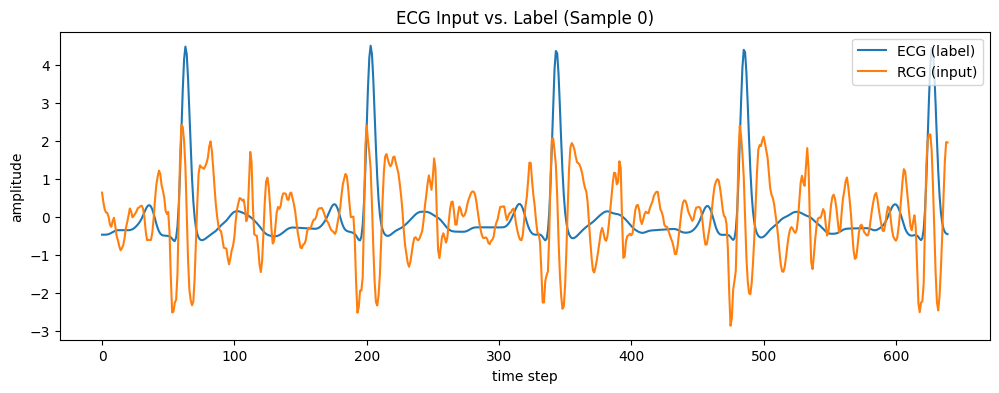

In [15]:
import matplotlib.pyplot as plt
import torch

batch = next(iter(data_loader_train))
inputs, labels, pos = batch

label_batch = labels.detach().cpu().numpy()
input_batch = inputs.detach().cpu().numpy()


plt.figure(figsize=(12, 4))
label0 = label_batch[0, :]
inputMean = input_batch.mean(axis=1).squeeze()[0, :]
plt.plot(label0, label='ECG (label)')
plt.plot(inputMean, label='RCG (input)')
plt.xlabel('time step')
plt.ylabel('amplitude')
plt.legend()
plt.title('ECG Input vs. Label (Sample 0)')
plt.show()



In [21]:
# 释放上面验证代码块加载数据使用的内存
del dataset_train
del dataset_val
del data_loader_train
del data_loader_val
import gc
gc.collect()

1942

In [17]:
if __name__ == '__main__':
    np.random.seed(42)
    torch.manual_seed(42)
    parser = get_args_parser()
    args, unkowns = parser.parse_known_args()

    if args.output_dir:
        Path(args.output_dir).mkdir(parents=True, exist_ok=True)

    mode = 'train'  # infer or train

    if mode == 'train':
        main(args, mode=mode)
    else:
        # eval 已经放在了每个epoch结束后执行
        pass
    

train mode...
Training RCG shape: (25900, 50, 1, 640)
Training ECG shape: (25900, 640)
Training pozXYZ shape: torch.Size([25900, 50, 3])
Testing RCG shape: (3114, 50, 1, 640)
Testing ECG shape: (3114, 640)
Testing pozXYZ shape: torch.Size([3114, 50, 3])
Epoch 1
Length of data_loader_train is 405
Training...
log_dir: ./output_dir_pretrained


d:\Code\Python\ECG\misc.py:255: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self._scaler = torch.cuda.amp.GradScaler()


Load data time: 0.0004, Model process time: 0.4935, Backward time: 0.2775
Epoch: 1, Step: 0, Loss: 0.8637596964836121, LR: 0.0001
Load data time: 0.0001, Model process time: 0.0881, Backward time: 0.1425
Epoch: 1, Step: 1, Loss: 0.8519183993339539, LR: 0.0001
Load data time: 0.0001, Model process time: 0.0800, Backward time: 0.1437
Epoch: 1, Step: 2, Loss: 0.8464215397834778, LR: 0.0001
Load data time: 0.0001, Model process time: 0.0788, Backward time: 0.1413
Epoch: 1, Step: 3, Loss: 0.8185556530952454, LR: 0.0001
Load data time: 0.0001, Model process time: 0.0842, Backward time: 0.1476
Epoch: 1, Step: 4, Loss: 0.8656940460205078, LR: 0.0001
Load data time: 0.0001, Model process time: 0.0926, Backward time: 0.1439
Epoch: 1, Step: 5, Loss: 0.8324018716812134, LR: 0.0001
Load data time: 0.0001, Model process time: 0.0899, Backward time: 0.1393
Epoch: 1, Step: 6, Loss: 0.8101345896720886, LR: 0.0001
Load data time: 0.0001, Model process time: 0.0818, Backward time: 0.1508
Epoch: 1, Step: 

KeyboardInterrupt: 

In [ ]:
# 原来的训练流程
# for epoch in range(num_epochs):
#     accumulate_loss = 0
#     for i, [inputs, posXYZ_tensor, labels] in enumerate(dataloader, 0):
#         # Forward pass
#         torch.cuda.synchronize()
#         model = model.train()
#         outputs = model(inputs.to("cuda"), posXYZ_tensor.to("cuda"))

#         # Compute the loss
#         loss = criterion(outputs.to("cpu"), labels.to(torch.long))
#         accumulate_loss += loss.item()

#         # Backward and optimize
#         optimizer.zero_grad()
#         loss.backward()
#         optimizer.step()
#         torch.cuda.synchronize()

#         # Print the loss for every epoch
#         if i%100 == 0:
#             print(f'Epoch [{epoch+1}/{num_epochs}], Training Loss: {accumulate_loss / (i+1):.4f}')

#     accumulate_loss = 0
#     with torch.no_grad():
#         for i, [inputs, posXYZ_tensor, labels] in enumerate(testloader, 0):
#             model = model.eval()
#             outputs = model(inputs.to("cuda"), posXYZ_tensor.to("cuda"))
#             loss = criterion(outputs.to("cpu"), labels.to(torch.long))
#             accumulate_loss += loss.item()
#     print(f'Epoch [{epoch+1}/{num_epochs}], Validation Loss: {accumulate_loss / (i+1):.4f}')
#     if epoch == 0:
#         best_loss = accumulate_loss
#     if accumulate_loss <= best_loss:
#         torch.save(model.state_dict(), 'test.pth')
#         best_loss = accumulate_loss
#         print('Model saved')

# Step9 验证绘图

In [27]:



# 加载权重
#checkpoint_path = 'D:\Code\Python\ECG\output_dir_pretrained\onlyMat1JianqiaoModel\checkpoint-286.pth'
checkpoint_path = 'D:\Code\Python\ECG\output_dir_pretrained\sydneyDataJianqiaoModel\checkpoint-263.pth'
checkpoint = torch.load(checkpoint_path, weights_only=False)

# 初始化模型
#model = ECGFormer(encoder_parameter, num_inputs, num_channels).to(device)
model = airECG_catFusion_newTCN(hidden_size=60,output_size=640)

# 加载权重
model.load_state_dict(checkpoint['model'])

# 打印模型参数
for name, param in model.named_parameters():
    print(f"Layer: {name}, Param Mean: {param.mean().item()}, Param Std: {param.std().item()}")


Layer: ConvLayers.conv1.0.weight, Param Mean: 0.0493229515850544, Param Std: 0.08343461900949478
Layer: ConvLayers.conv1.0.bias, Param Mean: 0.39270856976509094, Param Std: nan
Layer: ConvLayers.conv1.2.weight, Param Mean: 1.0321073532104492, Param Std: nan
Layer: ConvLayers.conv1.2.bias, Param Mean: -0.011915674433112144, Param Std: nan
Layer: ConvLayers.conv1.3.weight, Param Mean: 0.040357232093811035, Param Std: 0.20964890718460083
Layer: ConvLayers.conv1.3.bias, Param Mean: -0.010502371937036514, Param Std: 0.2547614574432373
Layer: ConvLayers.conv1.5.weight, Param Mean: 0.9974706768989563, Param Std: 0.018327224999666214
Layer: ConvLayers.conv1.5.bias, Param Mean: -0.00931953638792038, Param Std: 0.02519533410668373
Layer: ConvLayers.conv2.0.weight, Param Mean: -0.00035604488220997155, Param Std: 0.08023335784673691
Layer: ConvLayers.conv2.0.bias, Param Mean: 0.05667868256568909, Param Std: 0.0827452689409256
Layer: ConvLayers.conv2.2.weight, Param Mean: 0.9996461868286133, Param 

d:\anaconda3\envs\ECG\lib\site-packages\torch\nn\utils\weight_norm.py:143: FutureWarning: `torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.
  WeightNorm.apply(module, name, dim)
C:\Users\Admin\AppData\Local\Temp\ipykernel_10768\3180466218.py:15: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\pytorch\aten\src\ATen\native\ReduceOps.cpp:1839.)
  print(f"Layer: {name}, Param Mean: {param.mean().item()}, Param Std: {param.std().item()}")


In [28]:

criterion = nn.MSELoss()
#criterion = CrossCorrelationAlignmentLoss(alpha=0.5, beta=0.5)  
accumulate_loss = 0
history_ecg = None
with torch.no_grad():
    for i, [inputs, labels, pos] in enumerate(data_loader_val, 0):
        if history_ecg is None:
            batch_size = inputs.size(0)
            #history_ecg = torch.zeros((batch_size, 640), device=device)
        model = model.half().to(device)
        model = model.eval()
        with autocast(device_type='cuda', dtype=torch.float16):
            #outputs = model(inputs.to("cuda"), pos.to("cuda"), history_ecg).flatten(1)
            outputs = model(inputs.to("cuda"), pos.to("cuda")).flatten(1)
            labels = labels.to(torch.float16)
            labels = labels.to("cuda")
            print(outputs.shape, outputs.dtype)
            print(labels.shape, labels.dtype)
            loss = criterion(outputs, labels)
        outputs = outputs.to("cpu")
        labels = labels.to("cpu")
        accumulate_loss += loss.item()
        if i == 10:
            break


print(f'Testing Loss: {accumulate_loss / (i+1):.4f}')


torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
torch.Size([64, 640]) torch.float16
Testing Loss: 0.5459


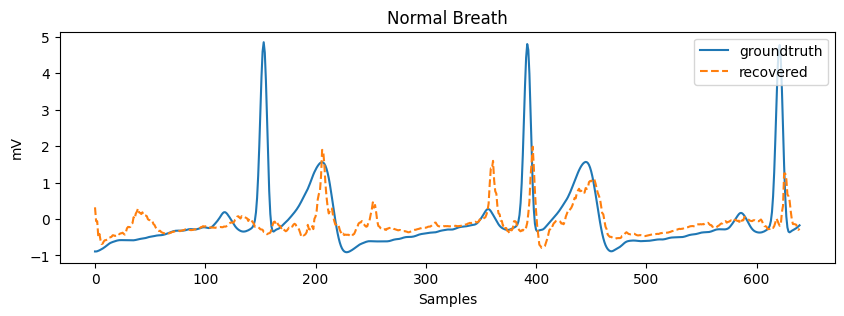

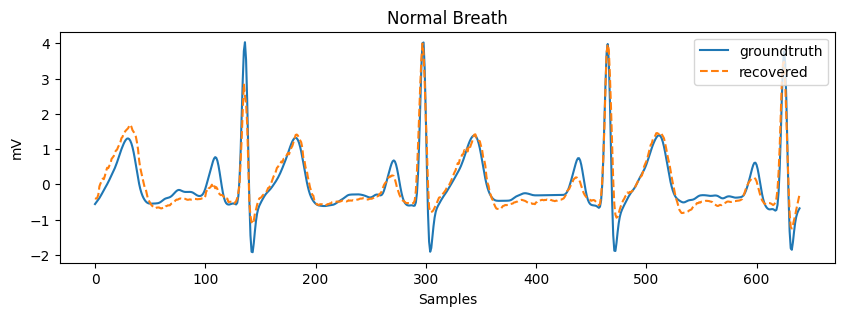

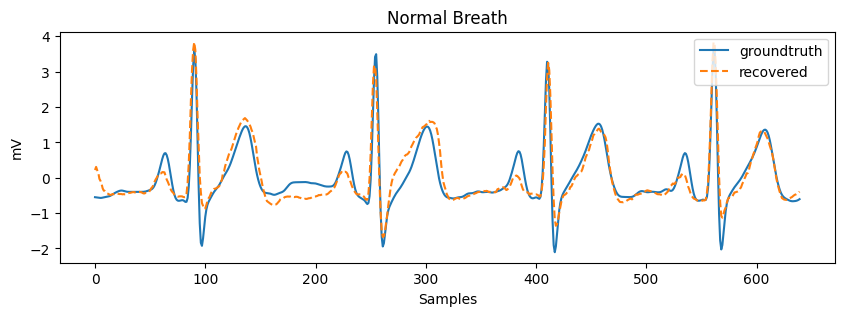

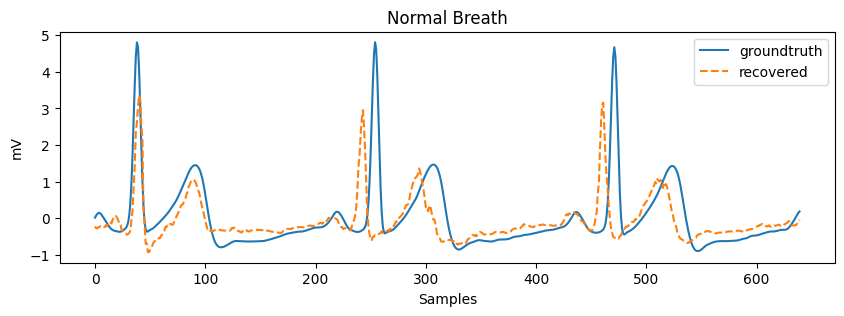

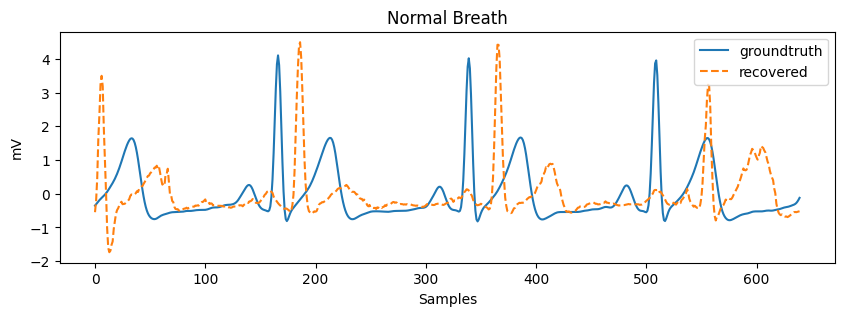

...

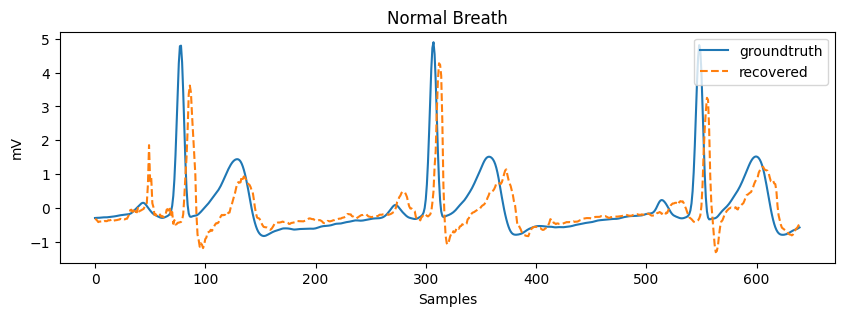

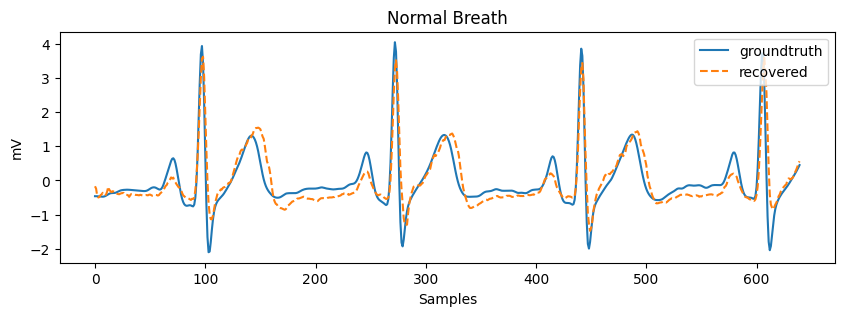

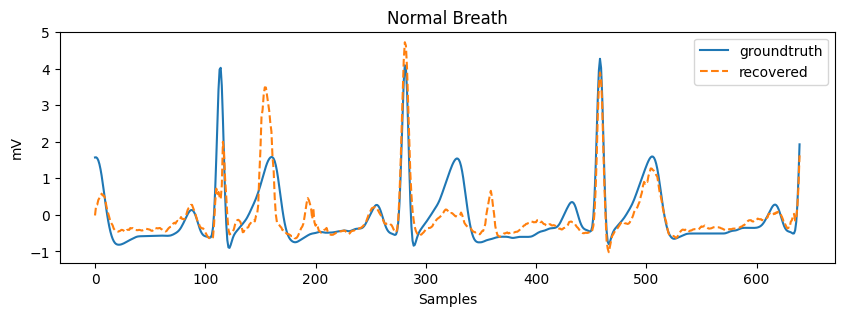

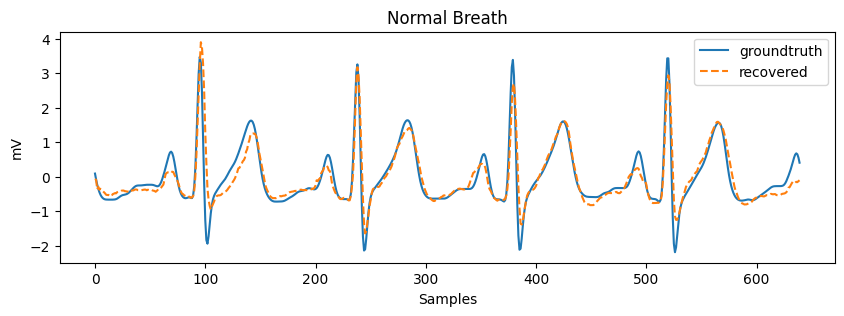

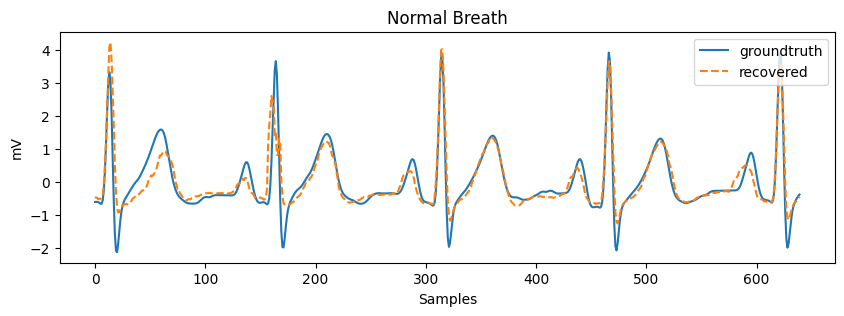

In [29]:
import matplotlib.pyplot as plt
labels = labels.to(dtype=torch.float16)
#outputs = align_signal(outputs, labels)
for i in range(64):
    plt.figure(figsize=(10,3))
    plt.plot(labels[i], label = "groundtruth")
    plt.plot(outputs[i], label = "recovered", linestyle='dashed')
    plt.title(f'Normal Breath')
    plt.xlabel('Samples')
    plt.ylabel('mV')
    plt.legend(loc=1)
    plt.show()
# plt.figure(figsize=(10,3))
# plt.plot(labels[1], label = "groundtruth")
# plt.plot(outputs[1], label = "recovered", linestyle='dashed')
# plt.title(f'Normal Breath Loss: {accumulate_loss / (i+1):.4f}')
# plt.xlabel('Samples')
# plt.ylabel('mV')
# plt.legend(loc=1)
# plt.show()